# Veri Kurulumu ve Kütüphaneler

In [1]:
import pandas as pd
import seaborn as sns

In [2]:
train = pd.read_csv('train.csv')

In [3]:
train

,Id,Open Date,City,City Group,Type,P1,P2,P3,P4,P5,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,revenue
0,0,07/17/1999,İstanbul,Big Cities,IL,4,5.0,4.0,4.0,2,...,3.0,5,3,4,5,5,4,3,4,5653753.0
1,1,02/14/2008,Ankara,Big Cities,FC,4,5.0,4.0,4.0,1,...,3.0,0,0,0,0,0,0,0,0,6923131.0
2,2,03/09/2013,Diyarbakır,Other,IL,2,4.0,2.0,5.0,2,...,3.0,0,0,0,0,0,0,0,0,2055379.0
3,3,02/02/2012,Tokat,Other,IL,6,4.5,6.0,6.0,4,...,7.5,25,12,10,6,18,12,12,6,2675511.0
4,4,05/09/2009,Gaziantep,Other,IL,3,4.0,3.0,4.0,2,...,3.0,5,1,3,2,3,4,3,3,4316715.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
132,132,06/25/2008,Trabzon,Other,FC,2,3.0,3.0,5.0,4,...,3.0,0,0,0,0,0,0,0,0,5787594.0
133,133,10/12/2006,İzmir,Big Cities,FC,4,5.0,4.0,4.0,2,...,3.0,0,0,0,0,0,0,0,0,9262754.0
134,134,07/08/2006,Kayseri,Other,FC,3,4.0,4.0,4.0,2,...,3.0,0,0,0,0,0,0,0,0,2544857.0
135,135,10/29/2010,İstanbul,Big Cities,FC,4,5.0,4.0,5.0,2,...,3.0,0,0,0,0,0,0,0,0,7217634.0


In [4]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 137 entries, 0 to 136
Data columns (total 43 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Id          137 non-null    int64  
 1   Open Date   137 non-null    object 
 2   City        137 non-null    object 
 3   City Group  137 non-null    object 
 4   Type        137 non-null    object 
 5   P1          137 non-null    int64  
 6   P2          137 non-null    float64
 7   P3          137 non-null    float64
 8   P4          137 non-null    float64
 9   P5          137 non-null    int64  
 10  P6          137 non-null    int64  
 11  P7          137 non-null    int64  
 12  P8          137 non-null    int64  
 13  P9          137 non-null    int64  
 14  P10         137 non-null    int64  
 15  P11         137 non-null    int64  
 16  P12         137 non-null    int64  
 17  P13         137 non-null    float64
 18  P14         137 non-null    int64  
 19  P15         137 non-null    i

In [5]:
import pandas_profiling
train.profile_report()

# Veri Mühendisliği

In [6]:
train['Open Date'] = pd.to_datetime(train['Open Date'], format='%m/%d/%Y')

In [7]:
train

,Id,Open Date,City,City Group,Type,P1,P2,P3,P4,P5,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,revenue
0,0,1999-07-17,İstanbul,Big Cities,IL,4,5.0,4.0,4.0,2,...,3.0,5,3,4,5,5,4,3,4,5653753.0
1,1,2008-02-14,Ankara,Big Cities,FC,4,5.0,4.0,4.0,1,...,3.0,0,0,0,0,0,0,0,0,6923131.0
2,2,2013-03-09,Diyarbakır,Other,IL,2,4.0,2.0,5.0,2,...,3.0,0,0,0,0,0,0,0,0,2055379.0
3,3,2012-02-02,Tokat,Other,IL,6,4.5,6.0,6.0,4,...,7.5,25,12,10,6,18,12,12,6,2675511.0
4,4,2009-05-09,Gaziantep,Other,IL,3,4.0,3.0,4.0,2,...,3.0,5,1,3,2,3,4,3,3,4316715.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
132,132,2008-06-25,Trabzon,Other,FC,2,3.0,3.0,5.0,4,...,3.0,0,0,0,0,0,0,0,0,5787594.0
133,133,2006-10-12,İzmir,Big Cities,FC,4,5.0,4.0,4.0,2,...,3.0,0,0,0,0,0,0,0,0,9262754.0
134,134,2006-07-08,Kayseri,Other,FC,3,4.0,4.0,4.0,2,...,3.0,0,0,0,0,0,0,0,0,2544857.0
135,135,2010-10-29,İstanbul,Big Cities,FC,4,5.0,4.0,5.0,2,...,3.0,0,0,0,0,0,0,0,0,7217634.0


**Sadece açılış yılından oluşan bir sütun oluşturdum**

In [22]:
train['Open Year'] = train['Open Date'].dt.year

In [39]:
train['Age'] = 2021 - train['Open Year']

In [40]:
train['Age']

0      22
1      13
2       8
3       9
4      12
       ..
132    13
133    15
134    15
135    11
136    12
Name: Age, Length: 137, dtype: int64

**Büyük şehirlerdeki restorantların gelirleri diğer şehirlere göre daha fazla**

In [24]:
cityPerc = train[["City Group", "revenue"]].groupby(['City Group'],as_index=False).mean()

<AxesSubplot:xlabel='City Group', ylabel='revenue'>

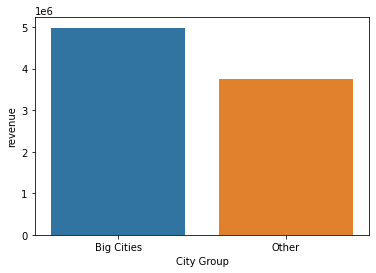

In [25]:
sns.barplot(x='City Group', y='revenue', data=cityPerc)

In [26]:
import matplotlib.pyplot as plt

<AxesSubplot:>

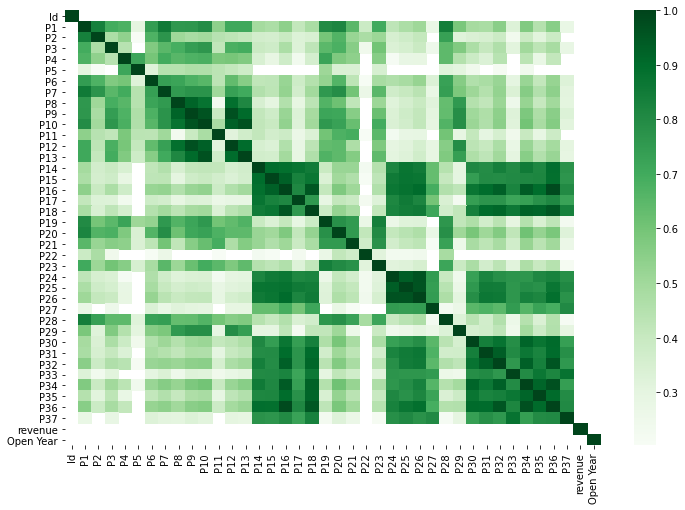

In [27]:
corr = train.corr()

kot = corr[corr>=.2]

plt.figure(figsize=(12,8))

sns.heatmap(kot, cmap='Greens')

# Modelleme

In [28]:
from sklearn.linear_model import LinearRegression #SKLEARN = Science Kit Learn
from sklearn.model_selection import train_test_split
from sklearn.linear_model import ElasticNet
from sklearn.tree import ExtraTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error
from sklearn.linear_model import Ridge,Lasso
from sklearn.metrics import mean_squared_error,r2_score

In [51]:
X = train[['City Group', 'Type', 'P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7', 'Age']]

In [52]:
X

,City Group,Type,P1,P2,P3,P4,P5,P6,P7,Age
0,Big Cities,IL,4,5.0,4.0,4.0,2,2,5,22
1,Big Cities,FC,4,5.0,4.0,4.0,1,2,5,13
2,Other,IL,2,4.0,2.0,5.0,2,3,5,8
3,Other,IL,6,4.5,6.0,6.0,4,4,10,9
4,Other,IL,3,4.0,3.0,4.0,2,2,5,12
...,...,...,...,...,...,...,...,...,...,...
132,Other,FC,2,3.0,3.0,5.0,4,2,4,13
133,Big Cities,FC,4,5.0,4.0,4.0,2,3,5,15
134,Other,FC,3,4.0,4.0,4.0,2,3,5,15
135,Big Cities,FC,4,5.0,4.0,5.0,2,2,5,11


In [53]:
X = pd.get_dummies(X)

In [54]:
y = train.revenue

In [55]:
X=pd.get_dummies(X,drop_first=True) # Dummies

In [56]:
X_train, X_test, y_train, y_test=train_test_split(X,y,test_size=0.2,random_state=13)

In [57]:
def algo_test(x, y):
    
    L = LinearRegression()
    E = ElasticNet()
    R = Ridge()
    Lass = Lasso()
    ETR = ExtraTreeRegressor()
    GBR = GradientBoostingRegressor()
    XGBC = XGBRegressor()
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=13)
    
    algos = [L, E, R, Lass, ETR, GBR, XGBC]
    algo_names= ['Linear', 'ElasticNet', 'Ridge', 'Lasso', 'Extra Tree', 'Gradient Boosting', 'XGBRegressor']
    r_squared = []
    rmse = []
    mae = []
    
    result = pd.DataFrame(columns = ['R_Squared', 'RMSE', 'MAE'],
                           index = algo_names)
    
    for algo in algos:
        algo.fit(X_train, y_train)
        algo.predict(X_test)
        
        r_squared.append(r2_score(y_test, algo.predict(X_test)))
        rmse.append(mean_squared_error(y_test, algo.predict(X_test))**.5)
        mae.append(mean_absolute_error(y_test, algo.predict(X_test)))
        
    result.R_Squared = r_squared
    result.RMSE = rmse
    result.MAE = mae
    
    return result.sort_values('R_Squared', ascending=False)

In [58]:
X

,P1,P2,P3,P4,P5,P6,P7,Age,City Group_Big Cities,City Group_Other,Type_DT,Type_FC,Type_IL
0,4,5.0,4.0,4.0,2,2,5,22,1,0,0,0,1
1,4,5.0,4.0,4.0,1,2,5,13,1,0,0,1,0
2,2,4.0,2.0,5.0,2,3,5,8,0,1,0,0,1
3,6,4.5,6.0,6.0,4,4,10,9,0,1,0,0,1
4,3,4.0,3.0,4.0,2,2,5,12,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
132,2,3.0,3.0,5.0,4,2,4,13,0,1,0,1,0
133,4,5.0,4.0,4.0,2,3,5,15,1,0,0,1,0
134,3,4.0,4.0,4.0,2,3,5,15,0,1,0,1,0
135,4,5.0,4.0,5.0,2,2,5,11,1,0,0,1,0


In [59]:
algo_test(X, y)

C:\Users\MONSTERHAN\anaconda3\lib\site-packages\xgboost\data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
C:\Users\MONSTERHAN\anaconda3\lib\site-packages\xgboost\data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(
C:\Users\MONSTERHAN\anaconda3\lib\site-packages\xgboost\data.py:112: UserWarning: Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
  warnings.warn(


,R_Squared,RMSE,MAE
ElasticNet,-0.931144,2.020500e+06,1.612050e+06
Lasso,-0.936594,2.023349e+06,1.622521e+06
Ridge,-0.965730,2.038513e+06,1.633537e+06
Linear,-0.968842,2.040126e+06,1.635010e+06
Gradient Boosting,-3.157374,2.964566e+06,2.226604e+06
XGBRegressor,-3.663928,3.139984e+06,2.351912e+06
Extra Tree,-9.695160,4.754941e+06,3.440780e+06
